In [53]:
import numpy as np
import plotly.graph_objects as go
from sklearn import svm, datasets
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

![iris](https://miro.medium.com/v2/resize:fit:1400/0*11IwZmSKXw77eYz5)

In [54]:

# Sample data for demonstration
iris = datasets.load_iris()


In [55]:
iris.keys()

dict_keys(['data', 'target', 'frame', 'target_names', 'DESCR', 'feature_names', 'filename', 'data_module'])

In [56]:
print(iris['DESCR'])

.. _iris_dataset:

Iris plants dataset
--------------------

**Data Set Characteristics:**

:Number of Instances: 150 (50 in each of three classes)
:Number of Attributes: 4 numeric, predictive attributes and the class
:Attribute Information:
    - sepal length in cm
    - sepal width in cm
    - petal length in cm
    - petal width in cm
    - class:
            - Iris-Setosa
            - Iris-Versicolour
            - Iris-Virginica

:Summary Statistics:

============== ==== ==== ======= ===== ====================
                Min  Max   Mean    SD   Class Correlation
============== ==== ==== ======= ===== ====================
sepal length:   4.3  7.9   5.84   0.83    0.7826
sepal width:    2.0  4.4   3.05   0.43   -0.4194
petal length:   1.0  6.9   3.76   1.76    0.9490  (high!)
petal width:    0.1  2.5   1.20   0.76    0.9565  (high!)
============== ==== ==== ======= ===== ====================

:Missing Attribute Values: None
:Class Distribution: 33.3% for each of 3 classes.
:Cr

In [57]:
df = pd.DataFrame(data=iris['data'], columns=iris['feature_names'])
df['target'] = iris['target']

In [58]:
df['target_descr'] = df['target'].map({0:'setosa', 1:'versicolor', 2:'virginica'})

df.head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target,target_descr
0,5.1,3.5,1.4,0.2,0,setosa
1,4.9,3.0,1.4,0.2,0,setosa
2,4.7,3.2,1.3,0.2,0,setosa
3,4.6,3.1,1.5,0.2,0,setosa
4,5.0,3.6,1.4,0.2,0,setosa


In [59]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 6 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   sepal length (cm)  150 non-null    float64
 1   sepal width (cm)   150 non-null    float64
 2   petal length (cm)  150 non-null    float64
 3   petal width (cm)   150 non-null    float64
 4   target             150 non-null    int64  
 5   target_descr       150 non-null    object 
dtypes: float64(4), int64(1), object(1)
memory usage: 7.2+ KB


In [60]:
df['target_descr'].value_counts()

target_descr
setosa        50
versicolor    50
virginica     50
Name: count, dtype: int64

In [61]:
df.describe()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target
count,150.000000,150.000000,150.000000,150.000000,150.000000
mean,5.843333,3.057333,3.758000,1.199333,1.000000
std,0.828066,0.435866,1.765298,0.762238,0.819232
min,4.300000,2.000000,1.000000,0.100000,0.000000
25%,5.100000,2.800000,1.600000,0.300000,0.000000
50%,5.800000,3.000000,4.350000,1.300000,1.000000
75%,6.400000,3.300000,5.100000,1.800000,2.000000
max,7.900000,4.400000,6.900000,2.500000,2.000000


Sepal average is the highest which makes sense

In [62]:
df.groupby('target_descr').describe().T

target_descr                setosa  versicolor  virginica
sepal length (cm) count  50.000000   50.000000  50.000000
                  mean    5.006000    5.936000   6.588000
                  std     0.352490    0.516171   0.635880
                  min     4.300000    4.900000   4.900000
                  25%     4.800000    5.600000   6.225000
                  50%     5.000000    5.900000   6.500000
                  75%     5.200000    6.300000   6.900000
                  max     5.800000    7.000000   7.900000
sepal width (cm)  count  50.000000   50.000000  50.000000
                  mean    3.428000    2.770000   2.974000
                  std     0.379064    0.313798   0.322497
                  min     2.300000    2.000000   2.200000
                  25%     3.200000    2.525000   2.800000
                  50%     3.400000    2.800000   3.000000
                  75%     3.675000    3.000000   3.175000
                  max     4.400000    3.400000   3.800000
petal length (cm) count  50.000000   50.000000  50.000000
                  mean    1.462000    4.260000   5.552000
                  std     0.173664    0.469911   0.551895
                  min     1.000000    3.000000   4.500000
                  25%     1.400000    4.000000   5.100000
                  50%     1.500000    4.350000   5.550000
                  75%     1.575000    4.600000   5.875000
                  max     1.900000    5.100000   6.900000
petal width (cm)  count  50.000000   50.000000  50.000000
                  mean    0.246000    1.326000   2.026000
                  std     0.105386    0.197753   0.274650
                  min     0.100000    1.000000   1.400000
                  25%     0.200000    1.200000   1.800000
                  50%     0.200000    1.300000   2.000000
                  75%     0.300000    1.500000   2.300000
                  max     0.600000    1.800000   2.500000
target            count  50.000000   50.000000  50.000000
                  mean    0.000000    1.000000   2.000000
                  std     0.000000    0.000000   0.000000
                  min     0.000000    1.000000   2.000000
                  25%     0.000000    1.000000   2.000000
                  50%     0.000000    1.000000   2.000000
                  75%     0.000000    1.000000   2.000000
                  max     0.000000    1.000000   2.000000

In [63]:
df.columns

Index(['sepal length (cm)', 'sepal width (cm)', 'petal length (cm)',
       'petal width (cm)', 'target', 'target_descr'],
      dtype='object')

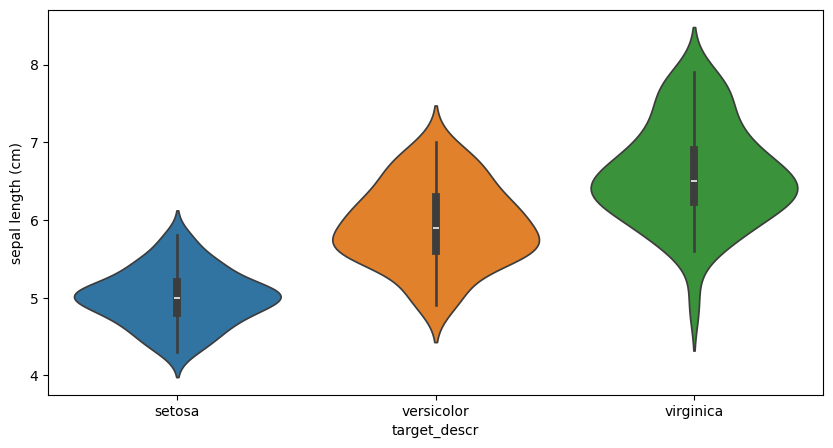

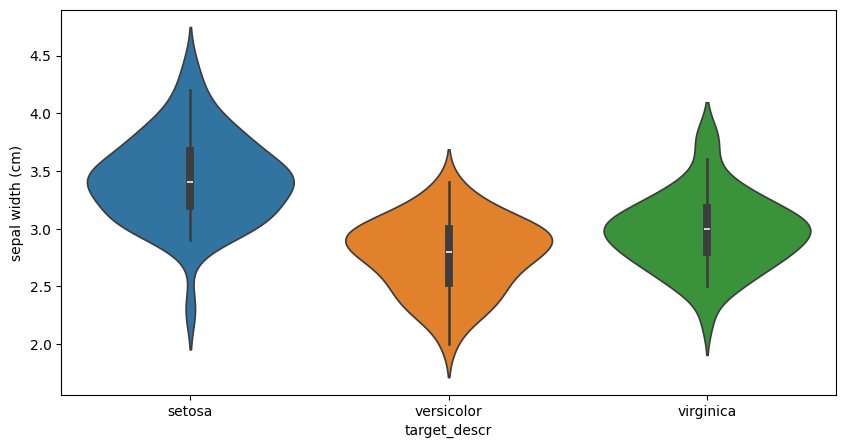

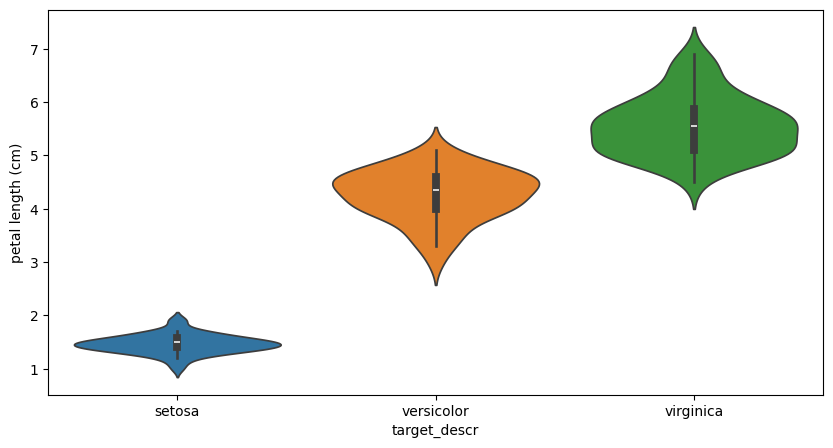

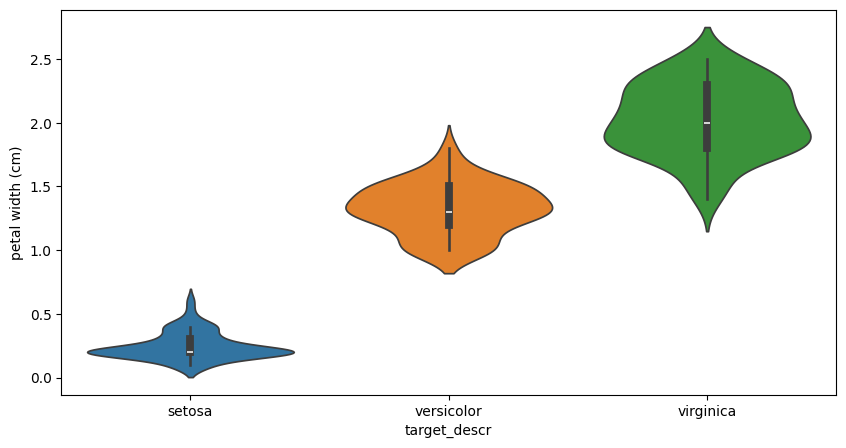

In [64]:
for col in df[['sepal length (cm)', 'sepal width (cm)', 'petal length (cm)',
       'petal width (cm)']].columns:
    plt.figure(figsize=(10, 5))
    sns.violinplot(x='target_descr', y=col, data=df, hue='target_descr')


- The data has low skewness
- There are different ranges in the data, so we need to scale it before ML

<Axes: >

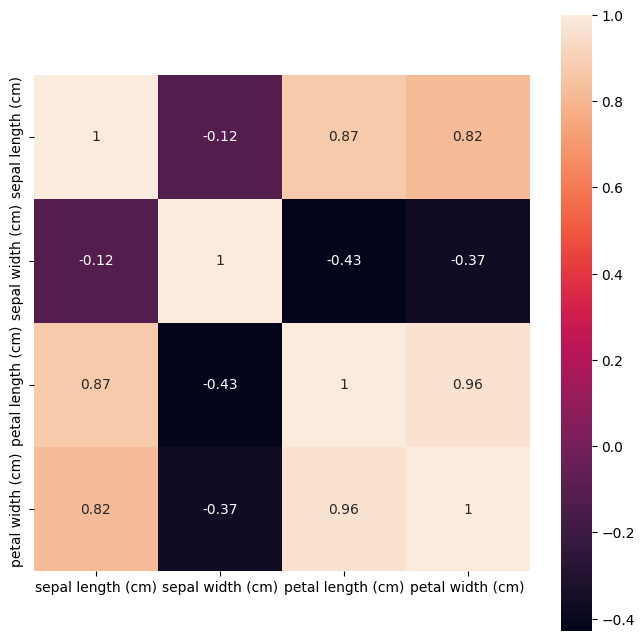

In [65]:
corr_matrix = df.drop(columns=['target', 'target_descr']).corr()
plt.figure(figsize=(8, 8))
sns.heatmap(corr_matrix, annot=True, square=True)

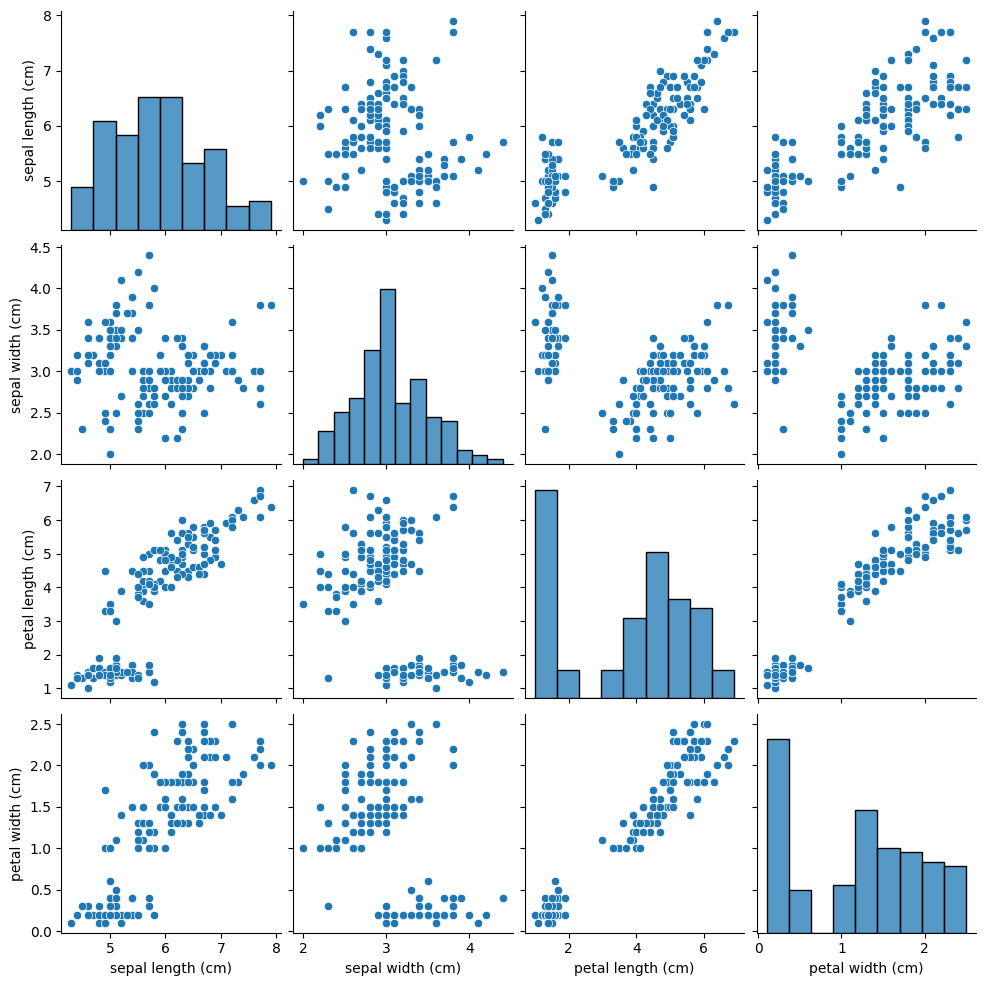

In [66]:
sns.pairplot(df.drop(columns=['target', 'target_descr']))

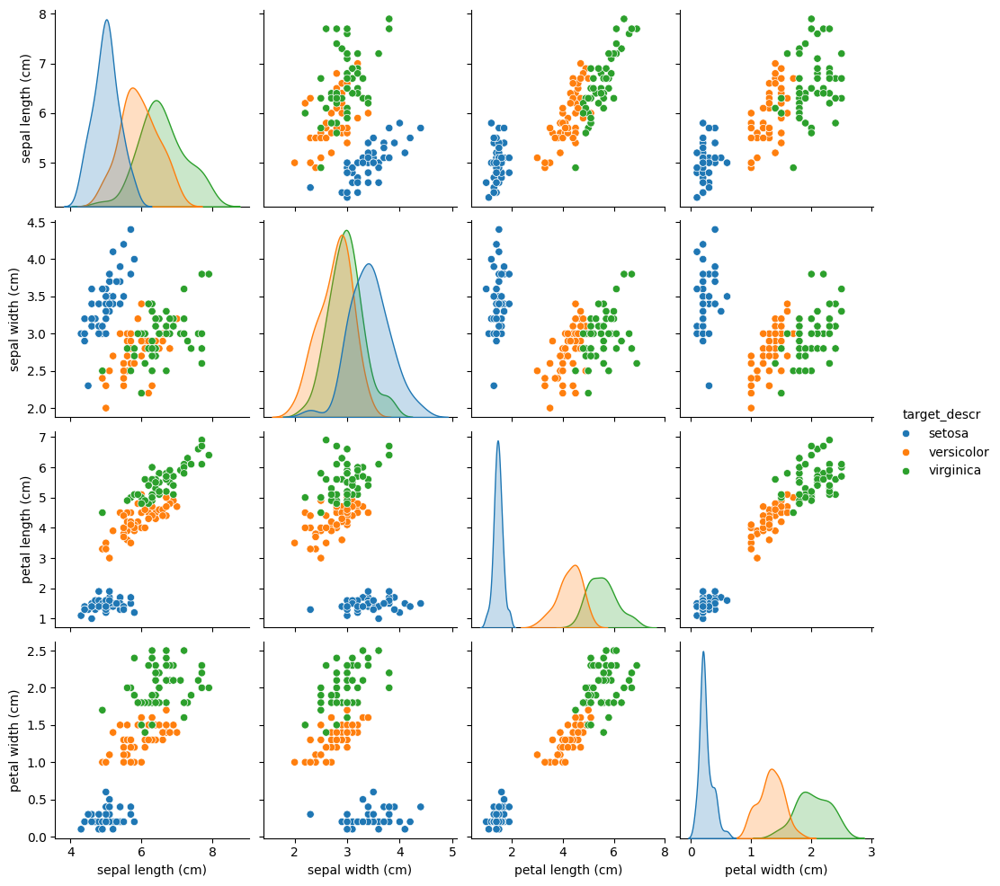

In [67]:
sns.pairplot(data=df.drop(columns='target'), hue='target_descr')

**Observation** The second pairplot explained the reason behind the spike in lower range, which is coming from setosa. This means it is the smallest flower.

In [68]:
X = iris.data[:, :2]  # We'll use only the first two features for visualization
y = iris.target

In [69]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [70]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42, stratify=y)

In [71]:
# Train an SVM classifier
svm_model = svm.SVC(kernel='linear', random_state=42)
svm_model.fit(X_train, y_train)


SVC(kernel='linear', random_state=42)

In [72]:

# Make predictions on the test set
y_pred = svm_model.predict(X_test)
y_pred

array([0, 1, 1, 1, 0, 2, 0, 0, 2, 1, 2, 2, 2, 2, 0, 0, 0, 1, 1, 1, 0, 2,
       2, 1, 2, 2, 2, 0, 2, 0])

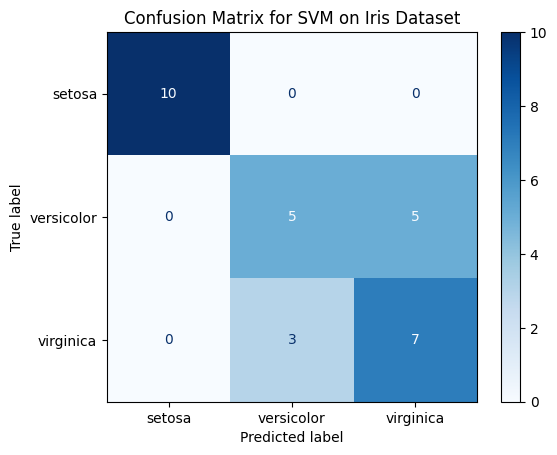

In [ ]:
# Compute the confusion matrix
svc_cm = confusion_matrix(y_test, y_pred)

# Display the confusion matrix
svc_cm_disp = ConfusionMatrixDisplay(confusion_matrix=svc_cm, display_labels=iris['target_names'])
svc_cm_disp.plot(cmap='Greens')
plt.title("Confusion Matrix for SVM on Iris Dataset")
plt.show()


**Interpreting the Numbers**
- setosa's prediction is 100%, the other 2 90%
* **10 in the top-left corner:** 10 Setosa flowers were correctly predicted as Setosa.
* **5 in the middle:** 5 Versicolor flowers were correctly predicted as Versicolor.
* **7 in the bottom-right corner:** 7 Virginica flowers were correctly predicted as Virginica.
* **5 in the middle of the second row:** 5 Versicolor flowers were incorrectly predicted as Virginica.
* **3 in the middle of the third row:** 3 Virginica flowers were incorrectly predicted as Versicolor.
- Accuracy = (10+9+9)/30 =0.933

**What This Tells Us**

* **Setosa:** The model does an excellent job of identifying Setosa flowers. All 10 actual Setosa were correctly classified.
* **Versicolor:** The model has some trouble with Versicolor. While it correctly classified 5, it misclassified 5 others as Virginica.
* **Virginica:** The model also struggles with Virginica, correctly classifying 7 but misclassifying 3 as Versicolor.

**Key Takeaways**

* The model perfectly separates Setosa from the other two classes.
* There's some confusion between Versicolor and Virginica, with the model sometimes mixing them up. This is common as these two species are more similar to each other than Setosa.

**Possible Reasons**

* **Feature Overlap:** The features used to train the model (sepal length, sepal width, petal length, petal width) might have some overlap between Versicolor and Virginica, making it harder for the model to distinguish them perfectly.
* **Model Complexity:** The model might not be complex enough to capture the subtle differences between Versicolor and Virginica.

**Next Steps**

* **Further Analysis:** You could investigate which specific features are causing the confusion between Versicolor and Virginica.
* **Model Improvement:** You might consider trying a more complex model or adjusting the existing one to improve its ability to separate these two classes.


> This result makes sense looking back at the visualizations setosa always stand out, versicolor and virginica weren't that much different.

In [21]:
# Generate a classification report
#report = classification_report(y_test, y_pred, target_names=iris.target_names)
#print("Classification Report:\n", report)



### **Understanding the Evaluation Metrics**
The **classification report** includes:
- **Accuracy**: Overall percentage of correct predictions.
- **Precision**: How many predicted class labels were actually correct (per class).
- **Recall (Sensitivity)**: How well the model identified actual positive cases (per class).
- **F1-score**: Harmonic mean of precision and recall, useful for imbalanced datasets.

#### **What to focus on?**
- If **accuracy is high**, the model performs well overall.
- If **precision is low** for a class, the model makes too many **false positives** for that class.
- If **recall is low** for a class, the model is missing too many **actual cases** for that class.
- **F1-score balances precision and recall** (important if the dataset is imbalanced).

#### **Example Interpretation (Hypothetical Output)**
```
               precision    recall  f1-score   support
    setosa        1.00       1.00      1.00        10
versicolor       0.92       0.92      0.92        10
 virginica       0.91       0.91      0.91        10

accuracy                              0.94        30
macro avg        0.94       0.94      0.94        30
weighted avg     0.94       0.94      0.94        30
```
- **Setosa (Class 0)** is perfectly classified.
- **Versicolor and Virginica** have slight misclassifications but still high performance.
- **Accuracy is 94%**, which is great for this dataset.

---

### **Conclusion**
- **SVM performed well on the Iris dataset** with high accuracy.
- **Confusion matrix** showed minimal misclassifications.
- **Precision, recall, and F1-scores are balanced**, meaning the model generalizes well.

This workflow gives a **structured approach** to evaluating an SVM classifier using the **Iris dataset** with a confusion matrix and meaningful evaluation metrics! 🚀

In [51]:
import numpy as np
import plotly.graph_objects as go
from sklearn import svm, datasets
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline

# Load the Iris dataset
iris = datasets.load_iris()
X = iris.data[:, :3]  # Use the first three features for 3D visualization
y = iris.target

# Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train SVM model
clf = make_pipeline(StandardScaler(), svm.SVC(kernel='linear'))
clf.fit(X_train, y_train)

# Predict on the test set
y_pred = clf.predict(X_test)

# Define colors for the three classes
colors = {0: 'blue', 1: 'red', 2: 'green'}
labels = {0: 'Setosa', 1: 'Versicolor', 2: 'Virginica'}

# Create 3D scatter plot for actual classes
fig = go.Figure()

# Actual Plot (Left)
for class_label in np.unique(y_test):
    fig.add_trace(go.Scatter3d(
        x=X_test[y_test == class_label, 0],
        y=X_test[y_test == class_label, 1],
        z=X_test[y_test == class_label, 2],
        mode='markers',
        marker=dict(size=5, color=colors[class_label]),
        name=f"Actual {labels[class_label]}",
        legendgroup=f"Actual {labels[class_label]}",
        showlegend=True
    ))

# Predicted Plot (Right)
for class_label in np.unique(y_pred):
    fig.add_trace(go.Scatter3d(
        x=X_test[y_pred == class_label, 0] + 5,  # Offset x-axis to separate plots
        y=X_test[y_pred == class_label, 1],
        z=X_test[y_pred == class_label, 2],
        mode='markers',
        marker=dict(size=5, color=colors[class_label], symbol="diamond"),
        name=f"Predicted {labels[class_label]}",
        legendgroup=f"Predicted {labels[class_label]}",
        showlegend=True
    ))

# Layout adjustments
fig.update_layout(
    title="SVM Model: Actual vs. Predicted Classification (3D)",
    scene=dict(
        xaxis_title=iris.feature_names[0],
        yaxis_title=iris.feature_names[1],
        zaxis_title=iris.feature_names[2]
    ),
    showlegend=True
)

# Show plot
fig.show()


In [45]:
import plotly.graph_objects as go
from sklearn import datasets
from sklearn import svm
import numpy as np

# Load Iris dataset
iris = datasets.load_iris()
X = iris.data[:, :3]  # Use first 3 features for 3D visualization
y = iris.target

# Train SVM model
clf = svm.SVC(kernel='linear')
clf.fit(X, y)

# Get hyperplane coefficients
w = clf.coef_
b = clf.intercept_

# Create meshgrid for 3D visualization
x_min, x_max = X[:, 0].min(), X[:, 0].max()
y_min, y_max = X[:, 1].min(), X[:, 1].max()
z_min, z_max = X[:, 2].min(), X[:, 2].max()
xx, yy, zz = np.meshgrid(np.linspace(x_min, x_max), np.linspace(y_min, y_max), np.linspace(z_min, z_max))

# Calculate hyperplane values
hyperplane = w[0, 0]*xx + w[0, 1]*yy + w[0, 2]*zz + b[0]
hyperplane2 = w[1, 0]*xx + w[1, 1]*yy + w[1, 2]*zz + b[1]
hyperplane3 = w[2, 0]*xx + w[2, 1]*yy + w[2, 2]*zz + b[2]

# Create Plotly figure
fig = go.Figure(data=[
    go.Scatter3d(x=X[:, 0], y=X[:, 1], z=X[:, 2], mode='markers', marker=dict(color=y)),
    go.Surface(x=xx.ravel(), y=yy.ravel(), z=hyperplane.ravel(), opacity=0.5, colorscale='Viridis'),
    go.Surface(x=xx.ravel(), y=yy.ravel(), z=hyperplane2.ravel(), opacity=0.5, colorscale='Plasma'),
    go.Surface(x=xx.ravel(), y=yy.ravel(), z=hyperplane3.ravel(), opacity=0.5, colorscale='Inferno')
])

# Customize plot
fig.update_layout(
    scene = dict(
        xaxis_title='Sepal Length',
        yaxis_title='Sepal Width',
        zaxis_title='Petal Length'),
    title='Iris Dataset SVM Hyperplane in 3D',
    width=800,
    height=600
)

# Show plot
fig.show()

In [11]:

# Train SVM model
clf = svm.SVC(kernel='linear')
clf.fit(X, y)

# Generate points on the decision plane
x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.1),
                     np.arange(y_min, y_max, 0.1))

# Predict the class labels for the grid points
Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)

# Create the 3D plot
fig = go.Figure(data=[go.Surface(x=xx, y=yy, z=Z)])
fig.update_traces(contours_z=dict(show=True, usecolormap=True,
                                  highlightcolor="limegreen", project_z=True))

# Customize the plot
fig.update_layout(title="3D Plot of SVM Decision Plane",
                  scene=dict(xaxis_title='Feature 1',
                             yaxis_title='Feature 2',
                             zaxis_title='Predicted Class'),
                  scene_camera=dict(eye=dict(x=1.7, y=-1.7, z=0.5)))

# Show the plot
fig.show()
